In [1]:
# Installations
!git clone https://github.com/nick01as/Generative-Dissection.git
!pip install ftfy regex
!pip install -U sentence-transformers
!pip install diffusers
!pip install accelerate
!pip install transformers
!pip install scipy
!pip install torchvision==0.15.1
!pip install tornado==5.1.1
!pip install -U scikit-learn
!pip install opencv-python
!pip install openai

In [2]:
# Import libraries

import os
home_dir = os.getcwd()
os.chdir("Generative-Dissection")

import torch
from itertools import permutations
from matplotlib import pyplot as plt

import clip
import utils 
import data_utils
import similarity

import numpy as np
import itertools

from sentence_transformers import SentenceTransformer

import pandas as pd
from torch.utils.data import Dataset, DataLoader
import random
import torchvision.transforms as transforms
import math
import statistics
from sklearn.linear_model import LinearRegression
from PIL import Image
import shutil

import subprocess
import json
import requests

from transformers import pipeline
from diffusers import StableDiffusionPipeline
from diffusers import DPMSolverMultistepScheduler
from tqdm import tqdm
import random
import torch.nn as nn

In [5]:
# Define variables for dissection
clip_name = 'ViT-B/16'
target_name = 'resnet50'
target_layer = 'layer3'
d_probe = 'imagenet_broden'
concept_set = 'data/20k.txt'

batch_size = 200
device = 'cuda'
pool_mode = 'avg'

save_dir = 'saved_activations'
similarity_fn = similarity.soft_wpmi
num_images_to_check = 10
blip_batch_size = 10
tag = "_"

In [4]:
ids_to_check = [44, 94, 170, 188, 192, 201, 236, 244, 245, 284, 299, 311, 316, 326, 327, 348, 386, 396, 397, 416, 417, 449, 473, 488, 504, 526, 574, 582, 607, 624]

In [7]:
# Load BLIP model

from transformers import BlipProcessor, BlipForConditionalGeneration

processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to(device) 
pretrained_dict = torch.load(BLIP_PATH)
model_dict = model.state_dict()
pretrained_dict = {k: v for k, v in pretrained_dict.items() if k in model_dict}
model_dict.update(pretrained_dict)
model.load_state_dict(model_dict)
model.eval()

BlipForConditionalGeneration(
  (vision_model): BlipVisionModel(
    (embeddings): BlipVisionEmbeddings(
      (patch_embedding): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (encoder): BlipEncoder(
      (layers): ModuleList(
        (0-11): 12 x BlipEncoderLayer(
          (self_attn): BlipAttention(
            (dropout): Dropout(p=0.0, inplace=False)
            (qkv): Linear(in_features=768, out_features=2304, bias=True)
            (projection): Linear(in_features=768, out_features=768, bias=True)
          )
          (layer_norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): BlipMLP(
            (activation_fn): GELUActivation()
            (fc1): Linear(in_features=768, out_features=3072, bias=True)
            (fc2): Linear(in_features=3072, out_features=768, bias=True)
          )
          (layer_norm2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
      )
    )
    (post_layernorm): LayerNorm((768,), eps=1e-0

In [8]:
# Initialize Stable Diffusion

model_id = "runwayml/stable-diffusion-v1-5"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe.safety_checker = lambda images, **kwargs: (images, [False] * len(images))
generator = torch.Generator(device=device).manual_seed(0)
pipe = pipe.to(device)

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [9]:
# Setting up OpenAI

headers = {
    "Content-Type": "application/json",
    "Authorization": OPENAI_KEY,
}

In [10]:
# Define OpenAI's GPT for one neuron description

def GPT_model_single(descriptions, model='gpt-3.5-turbo-0301', temperature=0.3):
    content_user_1 = (
        "State one coherent and concise concept label that is 1-5 words long that can semantically summarize and represent most, not necessarily all, of the conceptual similarities in the following descriptions: "
        + "a purple background with a very soft texture."
        + ", "
        + "a brown background with a diagonal pattern of lines and lines."
        + ", "
        + "a white windmill with a red door and a red door in the middle of the picture."
        + ", "
        + "a beige background with a rough texture of linen."
        + ", "
        + "a beige background with a rough texture and a very soft texture."
    )
    content_assist_1 = (
        "multicolored textiles"
    )
    content_user_2 = (
        "State one coherent and concise concept label that is 1-5 words long that can semantically summarize and represent most, not necessarily all, of the conceptual similarities in the following descriptions: "
        + "a little girl is sitting in a red tractor with the word sofy on the front."
        + ", "
        + "a toy car sits on a red ottoman in a play room."
        + ", "
        + "a red dress with silver studs and a silver belt."
        + ", "
        + "a red chevrolet camaro is on display at a car show."
        + ", "
        + "a red spool of a cable with the word red on it."
    )
    content_assist_2 = (
        "red-themed scenes"
    )
    
    content_user = "Only state your answer without a period and quotation marks and do not simply repeat the descriptions. State one coherent and concise concept label that is 1-5 words long and can semantically summarize and represent most, not necessarily all, of the conceptual similarities in the following descriptions: "
    for i in range(len(descriptions)):
        content_user = content_user + descriptions[i]
        if descriptions[i] != descriptions[-1]:
            content_user = content_user + ', '
            
    payload = {
        "model": model,
        "messages": [
            {
                "role": "user",
                "content": content_user_1
            },
            {
                "role": "assistant",
                "content": content_assist_1
            },
            {
                "role": "user",
                "content": content_user_2
            },
            {
                "role": "assistant",
                "content": content_assist_2
            },
            {
                "role": "user",
                "content": content_user
            }
        ],
        "temperature": temperature
    }
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    response_data = response.json()
    blip_pred = response_data['choices'][0]['message']['content']
    if ':' in blip_pred:
        pred_split = blip_pred.split(':')
        blip_pred = pred_split[1]

    refeed_content = "Only state your answer without a period and do not simply repeat the descriptions. State one coherent and concise concept label that is 1-5 words long that can semantically summarize and represent most, not necessarily all, of the conceptual similarities in the following descriptions: "

    if ',' in blip_pred:
        gpt_list = blip_pred.split(',')
        for i in range(len(gpt_list)):
            refeed_content = refeed_content + gpt_list[i]
            if gpt_list[i] != gpt_list[-1]:
                refeed_content = refeed_content + ', '
        payload = {
            "model": model,
            "messages": [
                {
                    "role": "user",
                    "content": refeed_content
                }
            ],
            "temperature": temperature
        }
        response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
        response_data = response.json()
        blip_pred = response_data['choices'][0]['message']['content']
        if ':' in blip_pred:
            pred_split = blip_pred.split(':')
            blip_pred = pred_split[1]

    return blip_pred

In [11]:
# Define OpenAI's GPT for text simplification

def GPT_simplify(description, model='gpt-3.5-turbo-0301', temperature=0.3):
    content_user_1 = (
        "State one coherent and concise concept label that is 1-5 words long that simplifies the following description: "
        + "a red background with a red background and a red background with a red background."
    )
    content_assist_1 = (
        "A red background"
    )
    
    content_user = "Only state your answer without a period and quotation marks. Do not number your answer. State one coherent and concise concept label that simplifies the following description and deletes any unnecessary details: "
    content_user += description
            
    payload = {
        "model": model,
        "messages": [
            {
                "role": "user",
                "content": content_user_1
            },
            {
                "role": "assistant",
                "content": content_assist_1
            },
            {
                "role": "user",
                "content": content_user
            }
        ],
        "temperature": temperature
    }
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    response_data = response.json()
    blip_pred = response_data['choices'][0]['message']['content']
        
    return blip_pred

In [12]:
# Setting up file/directory paths for saving results

pot_column_names = ['Neuron ID'] + ['Concept {}'.format(i) for i in range(5)]
all_concepts = pd.DataFrame(columns=pot_column_names)
result_column_names = ['Neuron ID', 'Label 1', 'Label 2', 'Label 3']
final_concepts = pd.DataFrame(columns=result_column_names)
threshold_column_names = ['Neuron ID','DnD Label 1', 'DnD Label 2', 'DnD Label 3','Image Embedding', 'Text Embedding']
threshold_results = pd.DataFrame(columns = threshold_column_names)

# adjust layers as necessary depending on target model
layer_dic = {'layer1':1, 'layer2':2, 'layer3':3, 'layer4':4, 'fc':'fc', 'encoder':'encoder'}

def create_layer_folder(layer, tag):
    
    os.chdir(home_dir)
    save_folder_name = '{}_{}_layer{}_results_{}'.format(target_name, d_probe, layer_dic[layer], tag)
    
    if not os.path.exists(save_folder_name):
        os.makedirs(save_folder_name)
        os.chdir(save_folder_name)
        os.makedirs('activating_image_figures')
        os.makedirs('all_potential_concepts')
        os.makedirs('all_result_concepts')
        os.makedirs('thresholding_results')
    
    os.chdir(home_dir)
    return

def save_image_path(layer, tag):
    return home_dir + "/{}_{}_layer{}_results_{}/activating_image_figures/".format(target_name, d_probe, layer_dic[layer], tag)
    
def save_potential_concept_path(layer, tag):
    return home_dir + "/{}_{}_layer{}_results_{}/all_potential_concepts/".format(target_name, d_probe, layer_dic[layer], tag)

def save_result_concepts_path(layer, tag):
    return home_dir + "/{}_{}_layer{}_results_{}/all_result_concepts/".format(target_name, d_probe, layer_dic[layer], tag)
    
def save_threshold_path(layer, tag):
    return home_dir + "/{}_{}_layer{}_results_{}/thresholding_results/".format(target_name, d_probe, layer_dic[layer], tag)

def save_activating_fig(fig, layer, neuron_id):
    os.chdir(save_image_path(layer, tag))
    fig.savefig('neuron_{}_fig.png'.format(neuron_id))
    os.chdir(home_dir)
    
def save_potential_concepts(concepts, neuron_id):
    all_concepts.loc[len(all_concepts)] = [neuron_id] + concepts
    
def save_final_results(labels, neuron_id):
    final_concepts.loc[len(final_concepts)] = [neuron_id] + labels

def save_threshold_results(neuron_id, data):
    threshold_results.loc[len(threshold_results)] = [neuron_id] + data
    

In [13]:
# Define Dataloader for BLIP

class CustomDataset(Dataset):
    def __init__(self, images):
        self.transform = transforms.ToTensor()
        self.data = [self.transform(image) for image in images]

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        image = self.data[index]
        return image

In [15]:
save_names = utils.get_save_names(clip_name = clip_name, target_name = target_name,
                                  target_layer = target_layer, d_probe = d_probe,
                                  concept_set = concept_set, pool_mode=pool_mode,
                                  save_dir = save_dir)

target_save_name, clip_save_name, text_save_name = save_names

_, target_feats = utils.get_similarity_from_activations(target_save_name, clip_save_name, 
                                                             text_save_name, similarity_fn, device=device)

with open(concept_set, 'r') as f: 
    words = (f.read()).split('\n')

pil_data = data_utils.get_data(d_probe)

100%|██████████| 1024/1024 [00:06<00:00, 156.00it/s]


torch.Size([1024, 20000])


In [16]:
# Get attention crops

# FC layers do not have feature maps
top_vals, top_ids = torch.topk(target_feats, k=num_images_to_check, dim=0)

all_imgs = []
all_img_ids = {neuron_id:[] for neuron_id in ids_to_check}

for t, orig_id in enumerate(ids_to_check):
    print("Cropping for Neuron {}/{}".format(t+1,len(ids_to_check)))
    activating_images = []
    for i, top_id in enumerate(top_ids[:, orig_id]):
        im, label = pil_data[top_id]
        im = im.resize([375,375])
        all_img_ids[orig_id].append(len(all_imgs))
        all_imgs.append(im)
        activating_images.append(im)
    cropped_images = []
    if(target_layer != 'fc'):
        cropped_images = utils.get_attention_crops(target_name, activating_images, orig_id, num_crops_per_image = 4, target_layers = [target_layer], device = device)

    for img in cropped_images:
        all_img_ids[orig_id].append(len(all_imgs))
        all_imgs.append(img)

Cropping for Neuron 1/30
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
Cropping for Neuron 2/30
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
Cropping for Neuron 3/30
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 14])
torch.Size([10, 1024, 14, 

Neuron: 44 (1/30)


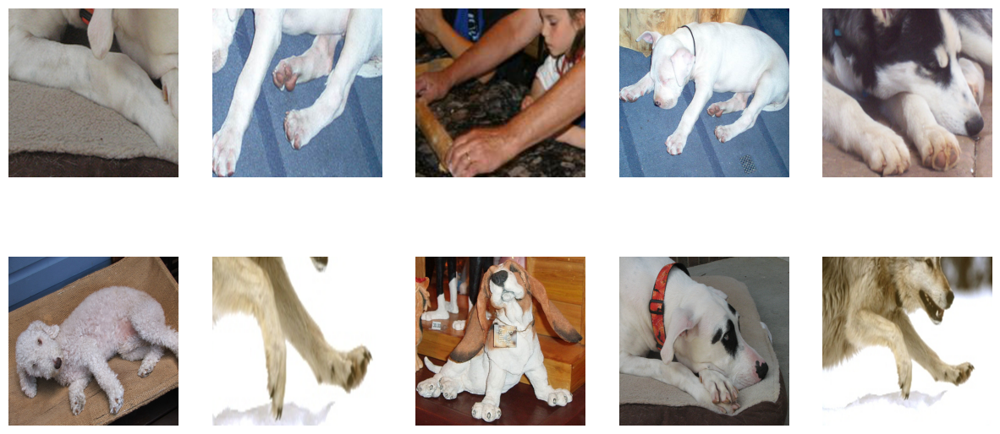

100%|██████████| 1/1 [00:00<00:00,  2.29it/s]


Image 1 caption: a white dog laying on a brown blanket
Image 2 caption: a white dog laying on a blue carpet
Image 3 caption: a woman and a child are making a wooden block
Image 4 caption: a white dog laying on a blue carpet
Image 5 caption: a dog laying on the ground
Image 6 caption: a white dog laying on a chair
Image 7 caption: a cat is standing on a white surface
Image 8 caption: a group of stuffed animals sitting on a wooden table
Image 9 caption: a dog laying on a pillow
Image 10 caption: a wolf running through the snow in the woods
Image 0 label: Animal-related scenes.
Image 1 label: White animals in various settings.
Image 2 label: White animals in various settings.
Image 3 label: Animals on furniture.
Image 4 label: Animal-related objects.
Neuron: 94 (2/30)


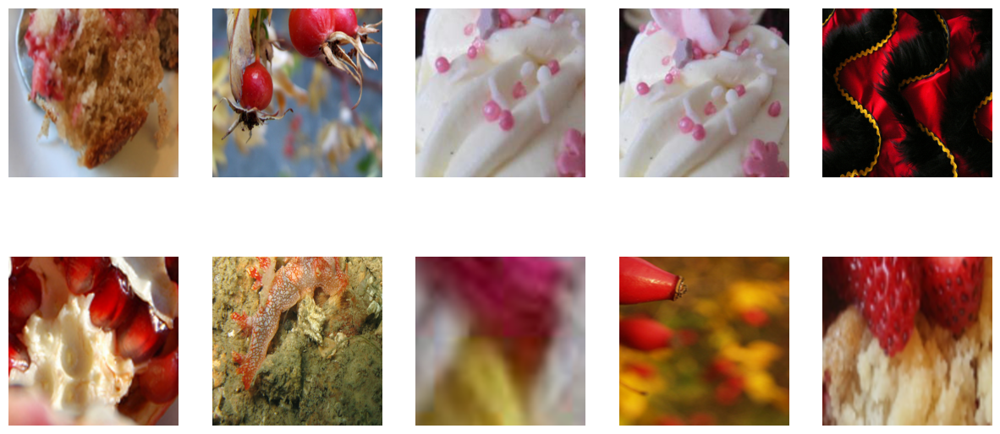

100%|██████████| 1/1 [00:00<00:00,  1.88it/s]


Image 1 caption: a piece of cake on a plate with a fork
Image 2 caption: the leaves are yellow
Image 3 caption: a white frosting cupcake
Image 4 caption: a cupcake with pink frosting and sprinng sprinngs
Image 5 caption: a red and black blanket
Image 6 caption: a person holding a pome with a biter
Image 7 caption: a red and white starfish
Image 8 caption: a vase with a flower in it
Image 9 caption: a red fire hydrant
Image 10 caption: a close up of a bowl of fruit
Image 0 label: Food and nature items.
Image 1 label: Colorful objects and food.
Image 2 label: Various Objects in Colors.
Image 3 label: Colorful objects.
Image 4 label: Colors and objects.
Neuron: 170 (3/30)


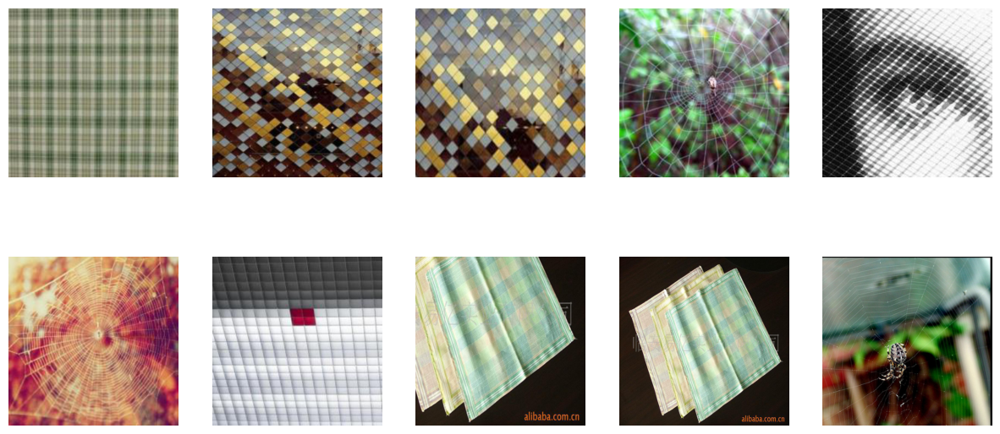

100%|██████████| 1/1 [00:00<00:00,  1.92it/s]


Image 1 caption: a green and white plaid fabric
Image 2 caption: a mosaic tile pattern in a bathroom
Image 3 caption: a brown and blue mosaic tile
Image 4 caption: a spider web in the middle of a forest
Image 5 caption: a black and white photo of a woman
Image 6 caption: a spider web in the middle of a spider web
Image 7 caption: a white ceiling with red squares
Image 8 caption: a set of four napkins with a green and white plaid pattern
Image 9 caption: a set of three napkins with a green and white checkered pattern
Image 10 caption: a spider is sitting on a web in a web
Image 0 label: Patterns and textures in nature and design.
Image 1 label: patterns and textures
Image 2 label: Patterns and textures.
Image 3 label: Patterns and Textures.
Image 4 label: Patterns and textures.
Neuron: 188 (4/30)


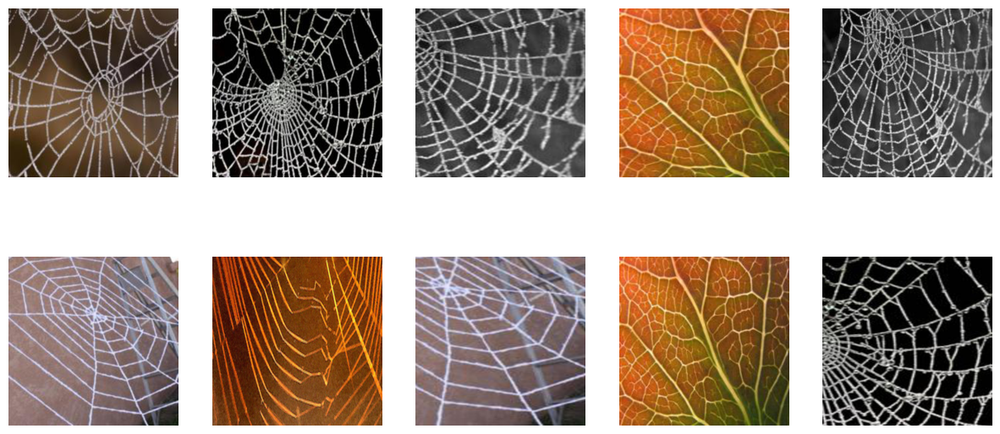

100%|██████████| 1/1 [00:00<00:00,  1.59it/s]


Image 1 caption: a spider web with water droplets on it
Image 2 caption: a spider web web with a spider web on it
Image 3 caption: a spider web web in the middle of a spider web web, spider web, spider web, spider web
Image 4 caption: a close up of a leaf with a red background
Image 5 caption: a spider web web with water droplets on it
Image 6 caption: a spider web on a brick wall
Image 7 caption: a spider web web with a spider web on it
Image 8 caption: a spider web on a brick wall
Image 9 caption: a close up of a leaf with a red background
Image 10 caption: a spider web web with a spider web on it
Image 0 label: Spider webs and nature.
Image 1 label: Spider webs and leaves.
Image 2 label: Spider webs and nature.
Image 3 label: Spider webs with droplets and red background.
Image 4 label: Spider webs and leaves.
Neuron: 192 (5/30)


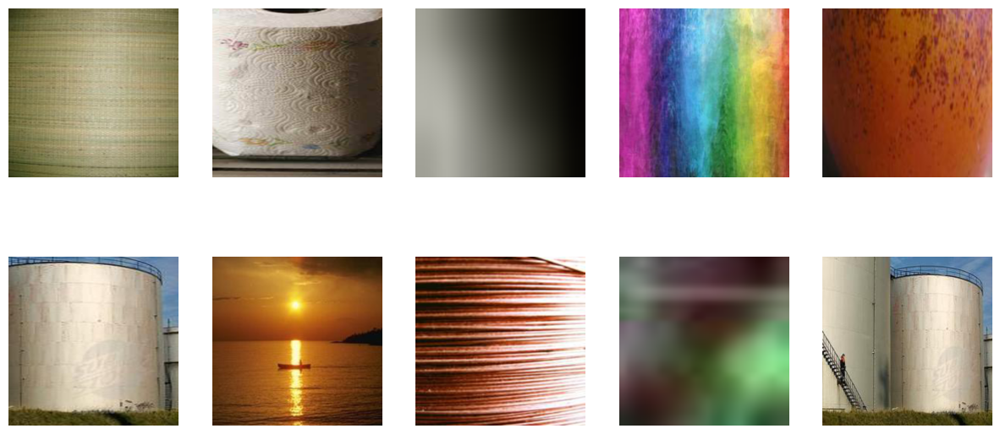

100%|██████████| 1/1 [00:00<00:00,  2.01it/s]


Image 1 caption: a large round lamp shade with a white background
Image 2 caption: a white toilet paper holder sitting on a shelf
Image 3 caption: a man in a suit and tie standing in front of a black background
Image 4 caption: a rainbow colored background with a white background
Image 5 caption: a glass of orange juice
Image 6 caption: a large white tank sitting on top of a green hill
Image 7 caption: the sun is setting over the water
Image 8 caption: a roll of copper wire
Image 9 caption: a blury background with a blur effect
Image 10 caption: a large white tank
Image 0 label: Everyday objects and scenery.
Image 1 label: Everyday objects and scenes.
Image 2 label: Colorful objects and scenes.
Image 3 label: Everyday objects and scenes.
Image 4 label: Everyday objects and scenes.
Neuron: 201 (6/30)


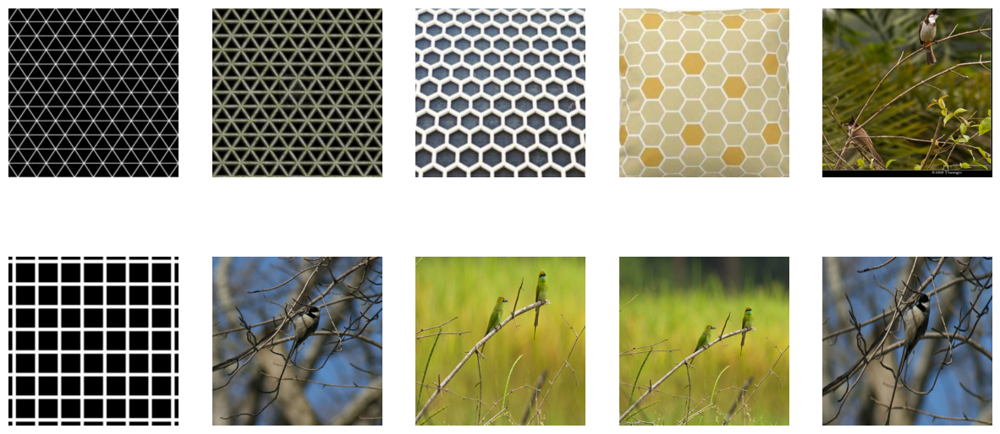

100%|██████████| 1/1 [00:00<00:00,  2.48it/s]


Image 1 caption: a black and white geometric pattern
Image 2 caption: a black and green pattern with a small diamond
Image 3 caption: a close up of a metal grating pattern
Image 4 caption: a yellow and white pillow with a honey pattern
Image 5 caption: a bird sitting on a branch
Image 6 caption: a black and white pattern with squares
Image 7 caption: a bird sitting on a branch
Image 8 caption: two birds on a branch
Image 9 caption: a bird sitting on a branch
Image 10 caption: a bird sitting on a branch
Image 0 label: Patterns and birds
Image 1 label: Bird and pattern motifs.
Image 2 label: Birds and patterns.
Image 3 label: Birds and patterns.
Image 4 label: Birds and patterns.
Neuron: 236 (7/30)


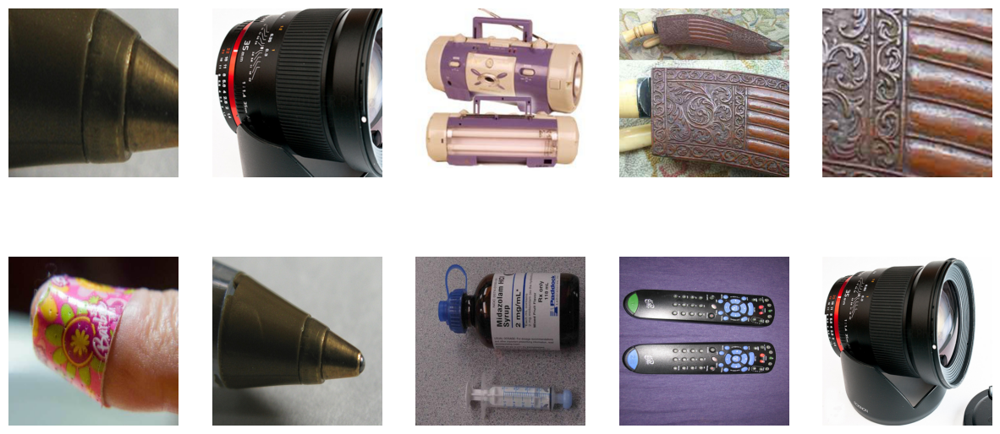

100%|██████████| 1/1 [00:00<00:00,  2.01it/s]


Image 1 caption: a close up of a pen with a white background
Image 2 caption: a camera lens on a white surface
Image 3 caption: a purple and white sewing machine
Image 4 caption: a carved wooden knife with a carved handle
Image 5 caption: a close up of a wooden fence with a metal plate
Image 6 caption: a persons finger with a pink and yellow flower pattern on it
Image 7 caption: a pen on a white surface
Image 8 caption: a bottle of insulin and a sy
Image 9 caption: two remotes on a purple blanket
Image 10 caption: a camera lens with a lens cap
Image 0 label: Objects with different textures and colors.
Image 1 label: Photography and writing tools.
Image 2 label: Objects on white background.
Image 3 label: Objects with distinct textures.
Image 4 label: Objects made of wood and plastic.
Neuron: 244 (8/30)


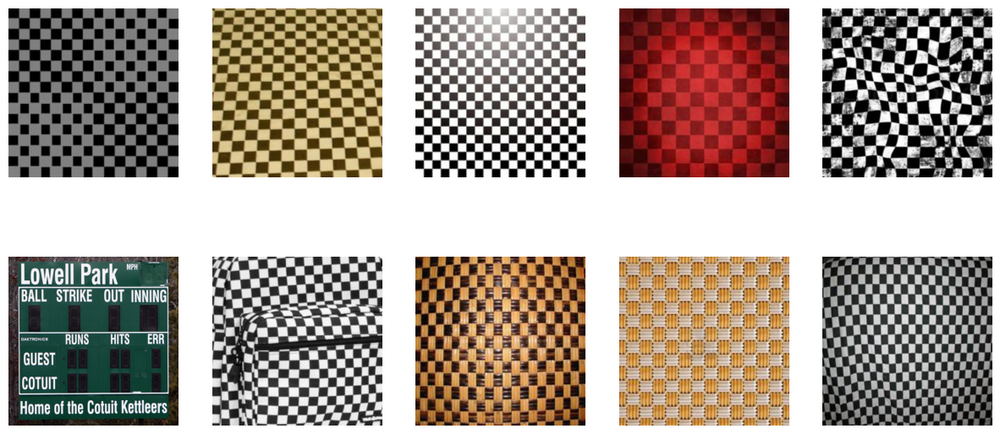

100%|██████████| 1/1 [00:00<00:00,  1.94it/s]


Image 1 caption: a black and white checkered pattern
Image 2 caption: a black and white checkered floor with a white and brown checkered pattern
Image 3 caption: a black and white checkered background
Image 4 caption: a red background with a checkered pattern
Image 5 caption: a black and white checkered pattern
Image 6 caption: a green sign with white letters
Image 7 caption: vans checker backpack
Image 8 caption: a woven basket with a black and white check pattern
Image 9 caption: a woven basket with a pattern of white and brown stripes
Image 10 caption: a black and white checkered hat with a black and white checkered pattern
Image 0 label: Checkered and woven items.
Image 1 label: Checkered items.
Image 2 label: Checkered and woven items.
Image 3 label: Checkered items and backgrounds.
Image 4 label: Checkered items.
Neuron: 245 (9/30)


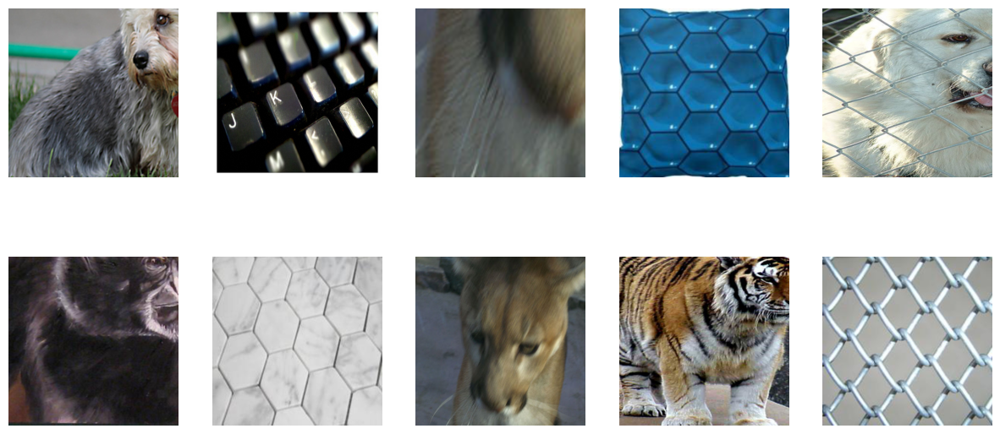

100%|██████████| 1/1 [00:00<00:00,  2.09it/s]


Image 1 caption: a dog with a red collar
Image 2 caption: a close up of a keyboard with the wordss on it
Image 3 caption: a blur of a cat
Image 4 caption: a blue pillow with a geometric pattern
Image 5 caption: a dog behind a fence
Image 6 caption: a black cat sitting on a table
Image 7 caption: a white marble tile with a hexagon pattern
Image 8 caption: a lion eating grass
Image 9 caption: a tiger standing on a rock
Image 10 caption: a close up of a chain link fence
Image 0 label: animals and objects in surroundings
Image 1 label: Animal-related items.
Image 2 label: Animal-related objects.
Image 3 label: animals and objects in surroundings.
Image 4 label: Animal-related objects.
Neuron: 284 (10/30)


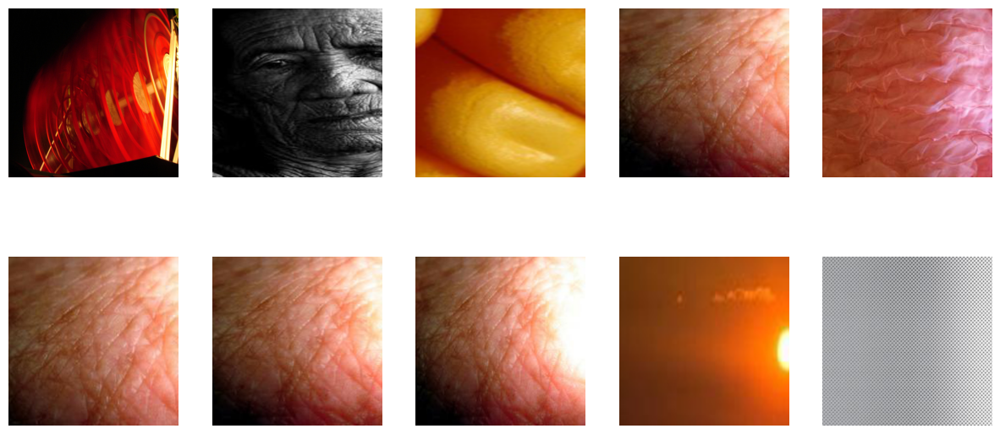

100%|██████████| 1/1 [00:00<00:00,  1.54it/s]


Image 1 caption: a red light is shining on a building
Image 2 caption: an old woman with wrness
Image 3 caption: a yellow nail with a white tip
Image 4 caption: a persons arm with a small white spot on the left arm
Image 5 caption: a pink tulle skirt with a large ru ru ru ru ru ru ru ru ru ru ru ru ru
Image 6 caption: a persons arm with a small white spot on the left arm
Image 7 caption: a close up of a persons arm
Image 8 caption: a close up of a persons skin
Image 9 caption: the sun is setting over the ocean
Image 10 caption: a white and grey metal texture background
Image 0 label: Color and texture.
Image 1 label: Body and Nature.
Image 2 label: Body parts and clothing.
Image 3 label: Body parts and textures.
Image 4 label: Visual elements.
Neuron: 299 (11/30)


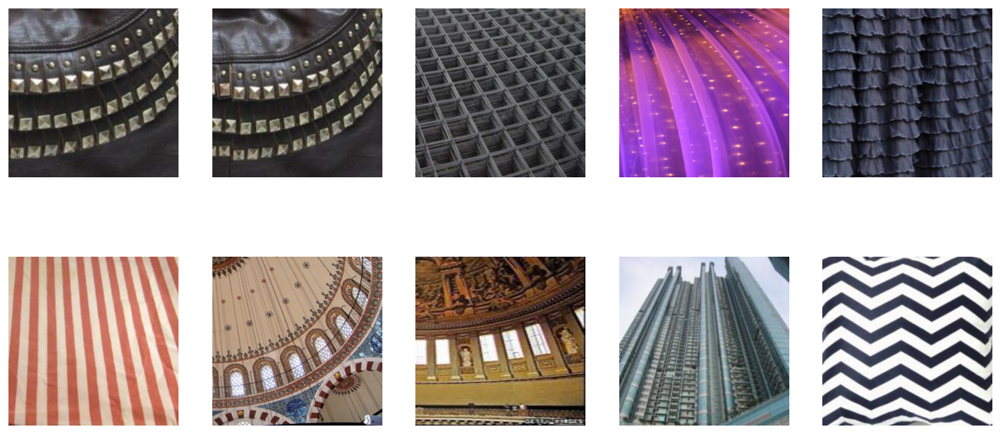

100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


Image 1 caption: a black purse with gold studs on it
Image 2 caption: a black leather purse with gold studs
Image 3 caption: welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded welded
Image 4 caption: purple and gold starlight backdrop
Image 5 caption: the skirt is made from a dark blue organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ organ
Image 6 caption: a red and white striped fabric
Image 7 caption: a dome with a clock inside of a building
Image 8 caption: the interior of the church
Image 9 caption: a tall building with a lot of windows
Image 10 caption: a navy and white pillow with a che pattern
Image 0 label: Fashion and architecture.
Image 1 label: Patterns and Structures.
Image 2 label: Metallic and textured objects.
Image 3 label: Metal and fabric items.
Image 4 label: Dark and metallic items.
Neuron: 311 (1

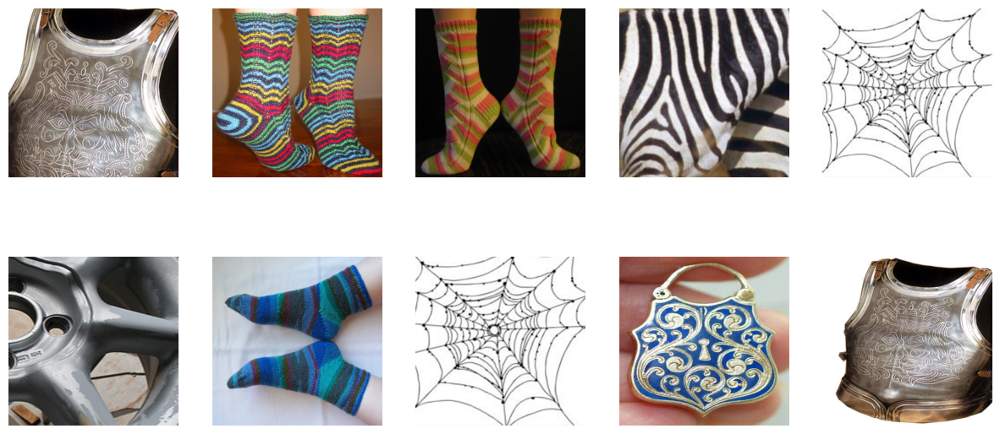

100%|██████████| 1/1 [00:00<00:00,  1.60it/s]


Image 1 caption: a silver and leather armor with a lion head
Image 2 caption: a woman wearing colorful socks and socks
Image 3 caption: a pair of socks with pink and green stripes
Image 4 caption: a group of zebras standing in a field
Image 5 caption: a spider web spider web spider web spider web spider web spider web spider web spider web spider web spider web
Image 6 caption: a wheel with a hole in the center
Image 7 caption: a pair of socks
Image 8 caption: a spider web spider web spider web spider web spider web spider web spider web spider web spider web spider web
Image 9 caption: a pair of earrings with blue enamel enamel enamel enamel enamel enamel enamel enamel enamel enamel enamel enamel enamel enamel enamel
Image 10 caption: a silver and gold armor with a dragon design
Image 0 label: Animal-inspired accessories and armor.
Image 1 label: Clothing and Accessories with Animal Motifs
Image 2 label: Assorted Accessories.
Image 3 label: Assorted Patterns and Textures.
Image 4 labe

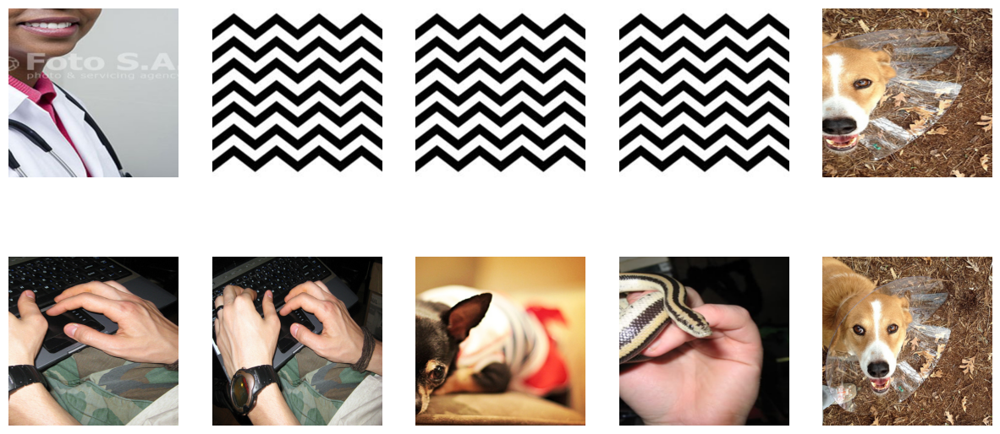

100%|██████████| 1/1 [00:00<00:00,  1.59it/s]


Image 1 caption: a female doctor in a white coat and black lab coat
Image 2 caption: black and white che che che che che che che che che che che che che che che che che che
Image 3 caption: black and white che che che che che che che che che che che che che che che che che che
Image 4 caption: black and white che che che che che che che che che che che che che che che che che che
Image 5 caption: a dog with a plastic bag on its head
Image 6 caption: a man wearing a watch
Image 7 caption: a man wearing a watch
Image 8 caption: a small dog laying on a couch
Image 9 caption: a small snake in a persons hand
Image 10 caption: a dog with a plastic collar
Image 0 label: Black and white pets and accessories.
Image 1 label: Pets and patterns.
Image 2 label: Black and white motifs.
Image 3 label: Black and white motifs.
Image 4 label: Black and white accessories and animals.
Neuron: 326 (14/30)


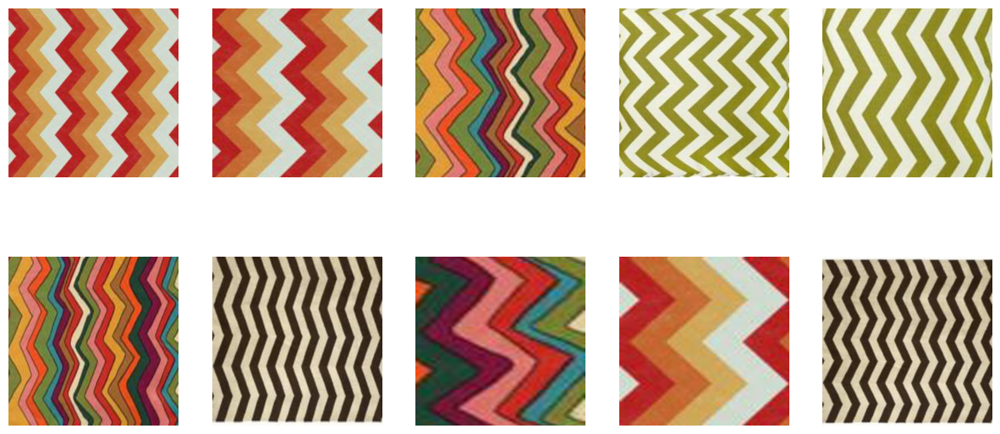

100%|██████████| 1/1 [00:00<00:00,  1.60it/s]


Image 1 caption: a red and yellow che che che che che che che che che che che che che che che che che
Image 2 caption: a red and yellow che che che che che che che che che che che che che che che che che
Image 3 caption: a colorful rug with wavy lines
Image 4 caption: a pair of green and white pillows
Image 5 caption: a green and white pillow with a zig pattern
Image 6 caption: a multi colored rug with wavy lines
Image 7 caption: a rug with a che pattern on it
Image 8 caption: a colorful pattern with a large, colorful, zigy design
Image 9 caption: a red and yellow che che che che che che che che che che che che che che che che che
Image 10 caption: a brown and white rug with a che pattern
Image 0 label: Colorful Geometric Patterns
Image 1 label: Chevron pattern decor.
Image 2 label: Zigzag and chevron patterns.
Image 3 label: Geometric patterned decor.
Image 4 label: Chevron and zigzag patterns.
Neuron: 327 (15/30)


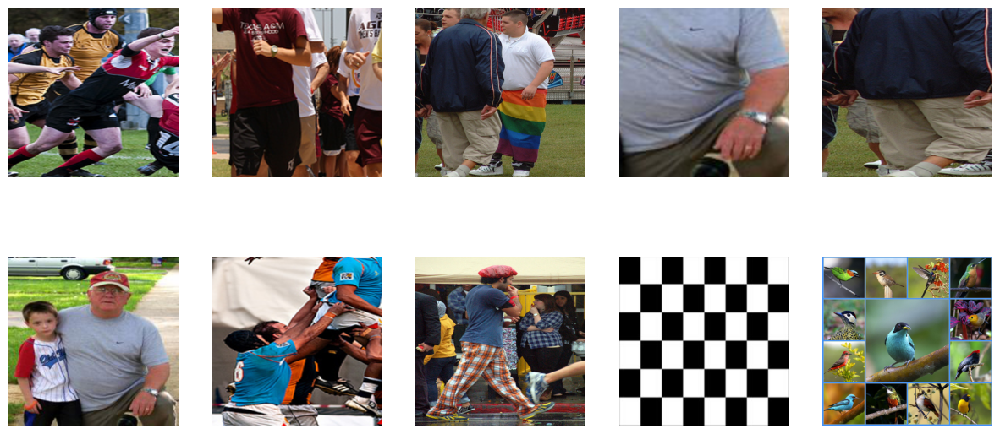

100%|██████████| 1/1 [00:00<00:00,  2.17it/s]


Image 1 caption: a group of men playing a game of rugby
Image 2 caption: a group of people walking down a street
Image 3 caption: a group of people standing around a man in a blue jacket
Image 4 caption: a man with a white shirt
Image 5 caption: a group of people standing around a fire hydra
Image 6 caption: a man and a boy
Image 7 caption: a group of men playing a game of rugby
Image 8 caption: a man wearing a red hat
Image 9 caption: a black and white checkered pattern
Image 10 caption: a col of birds
Image 0 label: Outdoor activities and objects.
Image 1 label: Group activities.
Image 2 label: People in various activities.
Image 3 label: Patterns and People
Image 4 label: Male activities and objects.
Neuron: 348 (16/30)


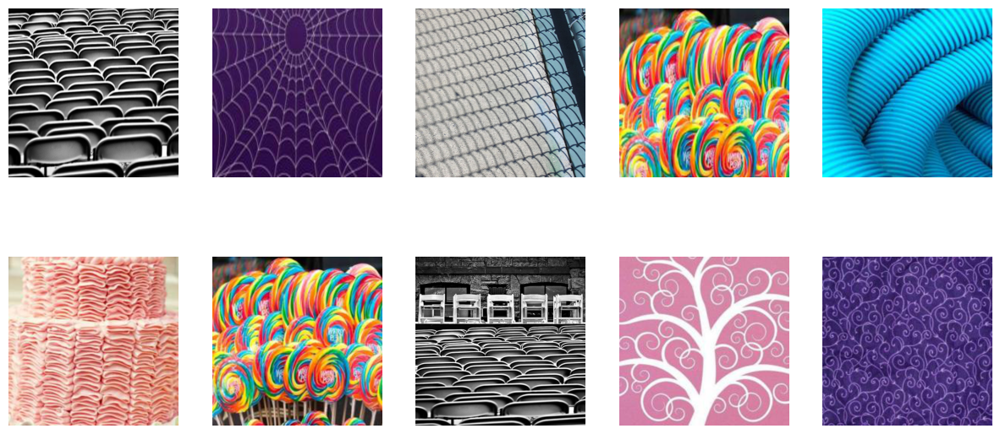

100%|██████████| 1/1 [00:00<00:00,  1.59it/s]


Image 1 caption: a black and white photo of a stadium
Image 2 caption: spider web spider web spider web spider web spider web spider web spider web spider web spider web spider web spider
Image 3 caption: a blue metal fence
Image 4 caption: a pile of los in a store
Image 5 caption: a blue spiral shaped object
Image 6 caption: a pink cake with ru ru ru ru ru ru ru ru ru ru ru ru ru ru ru ru ru
Image 7 caption: a bunch of los on a stick
Image 8 caption: a row of empty chairs
Image 9 caption: a white tree on a pink background
Image 10 caption: a purple background with swirls and swirls
Image 0 label: Abstract objects and scenes.
Image 1 label: Various visual objects.
Image 2 label: Colorful Objects and Scenes.
Image 3 label: Colorful objects and scenes.
Image 4 label: Colorful objects/scenes.
Neuron: 386 (17/30)


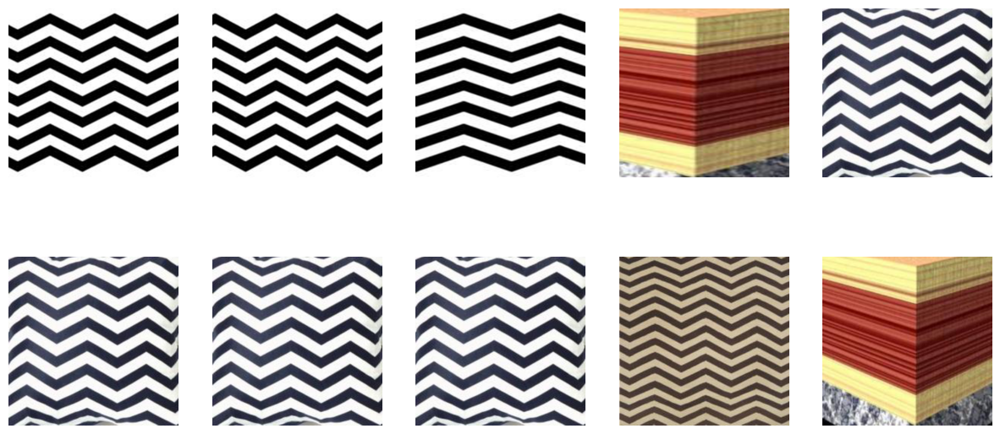

100%|██████████| 1/1 [00:00<00:00,  2.35it/s]


Image 1 caption: black and white chevron pattern
Image 2 caption: black and white chevron pattern
Image 3 caption: a black and white chevron pattern
Image 4 caption: a 3d image of a wooden structure
Image 5 caption: a navy and white pillow with a che pattern
Image 6 caption: a navy and white pillow with a che pattern
Image 7 caption: a navy and white pillow with a che pattern
Image 8 caption: a navy and white pillow with a che pattern
Image 9 caption: a brown and white rug with a che pattern
Image 10 caption: a piece of wood with a red and yellow stripe
Image 0 label: Geometric decor.
Image 1 label: Geometric home decor.
Image 2 label: Geometric home decor.
Image 3 label: Chevron-themed decor.
Image 4 label: Chevron-themed decor.
Neuron: 396 (18/30)


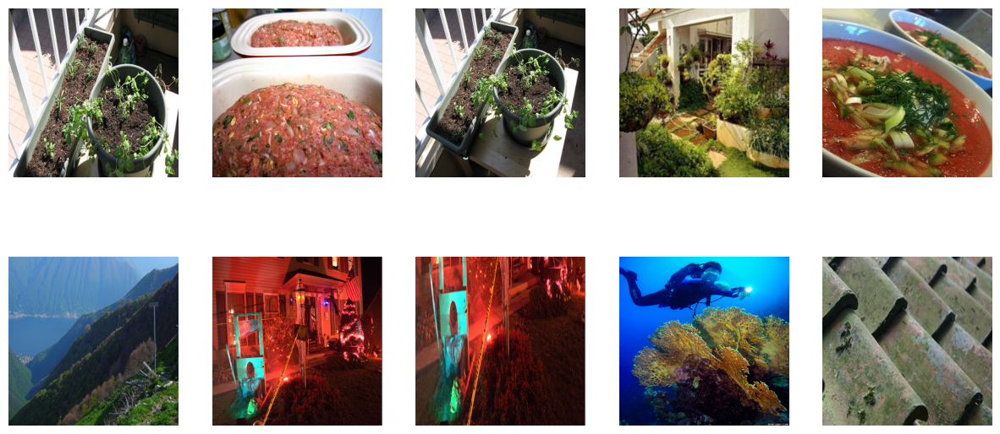

100%|██████████| 1/1 [00:00<00:00,  2.29it/s]


Image 1 caption: a white railing railing
Image 2 caption: a white bowl with meat
Image 3 caption: a pot of plants
Image 4 caption: the house is white
Image 5 caption: a bowl of soup
Image 6 caption: a mountain with a lake
Image 7 caption: a house with a christmas tree
Image 8 caption: a bus is parked on the side of the road
Image 9 caption: a scuba diver swimming over a coral reef
Image 10 caption: the roof is dirty
Image 0 label: White and Nature Scenes.
Image 1 label: Various Scenes with White Elements
Image 2 label: Assorted scenes.
Image 3 label: Assorted Scenes.
Image 4 label: Various scenes and objects.
Neuron: 397 (19/30)


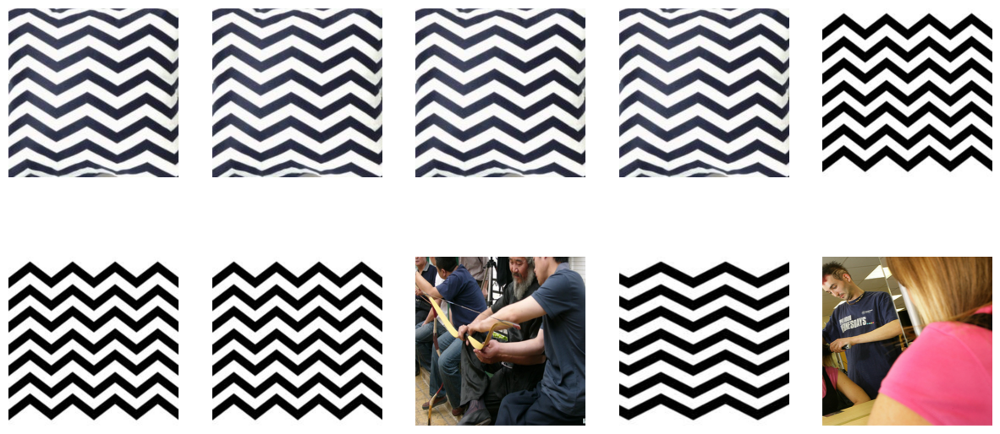

100%|██████████| 1/1 [00:00<00:00,  1.57it/s]


Image 1 caption: a navy and white pillow with a che pattern
Image 2 caption: a navy and white pillow with a che pattern
Image 3 caption: a navy and white pillow with a che pattern
Image 4 caption: a navy and white pillow with a che pattern
Image 5 caption: black and white che che che che che che che che che che che che che che che che che che
Image 6 caption: black and white che che che che che che che che che che che che che che che che che che
Image 7 caption: black and white che che che che che che che che che che che che che che che che che che
Image 8 caption: a group of men sitting on a bench
Image 9 caption: black and white chevron pattern
Image 10 caption: a woman wearing a pink shirt
Image 0 label: Geometric patterns and people.
Image 1 label: Monochrome patterns.
Image 2 label: Geometric patterns.
Image 3 label: Geometric patterns and colors.
Image 4 label: Monochrome and seating arrangements.
Neuron: 416 (20/30)


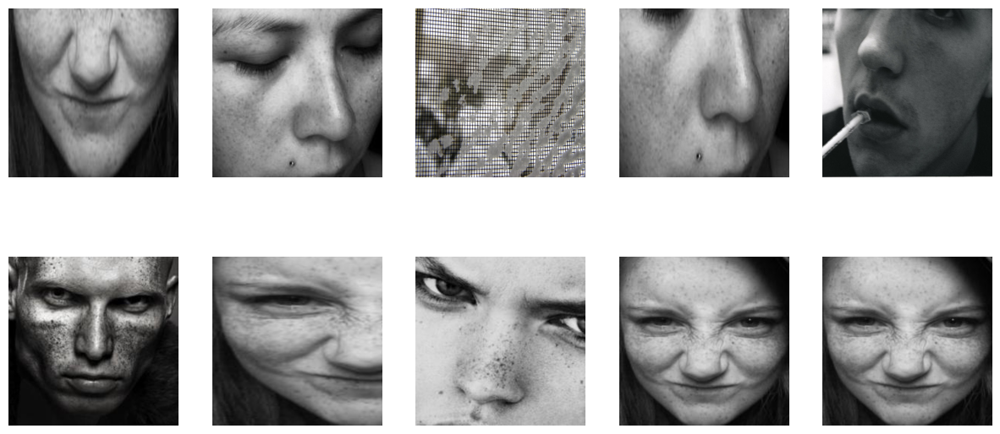

100%|██████████| 1/1 [00:00<00:00,  1.26it/s]


Image 1 caption: a woman with frng on her face
Image 2 caption: a woman with her eyes closed and her head down
Image 3 caption: a black and white photo of a window screen
Image 4 caption: a woman with frng on her face
Image 5 caption: a man with a cigarette in his mouth
Image 6 caption: a man with white paint on his face
Image 7 caption: a girl with a black and white photo of her face
Image 8 caption: a woman with frng frng frng frng frng frng frng frng frng frng frng frng frng frng
Image 9 caption: a woman with fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr
Image 10 caption: a woman with fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr
Image 0 label: Portraits of people's hair.
Image 1 label: Portraits of people.
Image 2 label: Portrait photography.
Image 3 label: Various hairstyles.
Image 4 label: Black and white portraits of women.
Neuron: 417 (21/30)


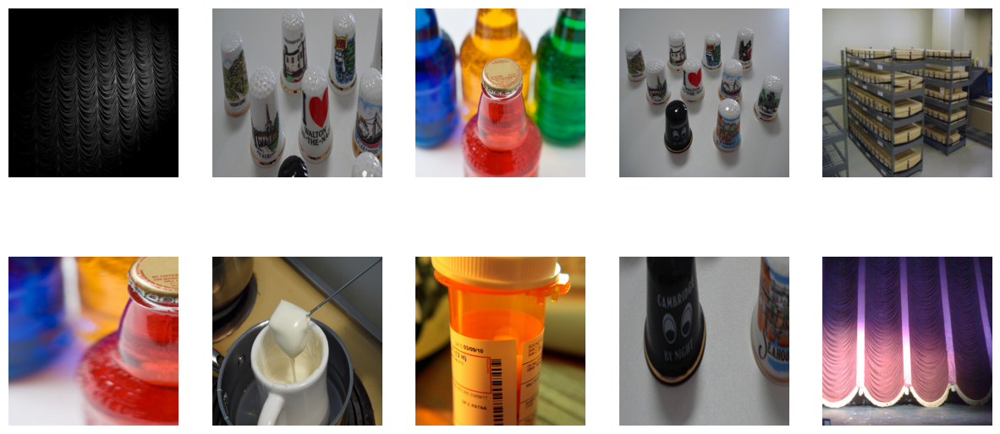

100%|██████████| 1/1 [00:00<00:00,  2.47it/s]


Image 1 caption: a black curtain with a black background
Image 2 caption: a white table with a bunch of small bottles
Image 3 caption: a bottle of soda
Image 4 caption: a white table top
Image 5 caption: a large room with shelves and shelves
Image 6 caption: a bottle of soda
Image 7 caption: a white cup with a white liquid
Image 8 caption: a bottle of medicine
Image 9 caption: a white table with a white table top
Image 10 caption: a stage with a curtain and a stage light
Image 0 label: White and black furnishings and objects.
Image 1 label: White and black objects in a room.
Image 2 label: Tabletop displays.
Image 3 label: Interior design elements.
Image 4 label: Table and Stage Setup.
Neuron: 449 (22/30)


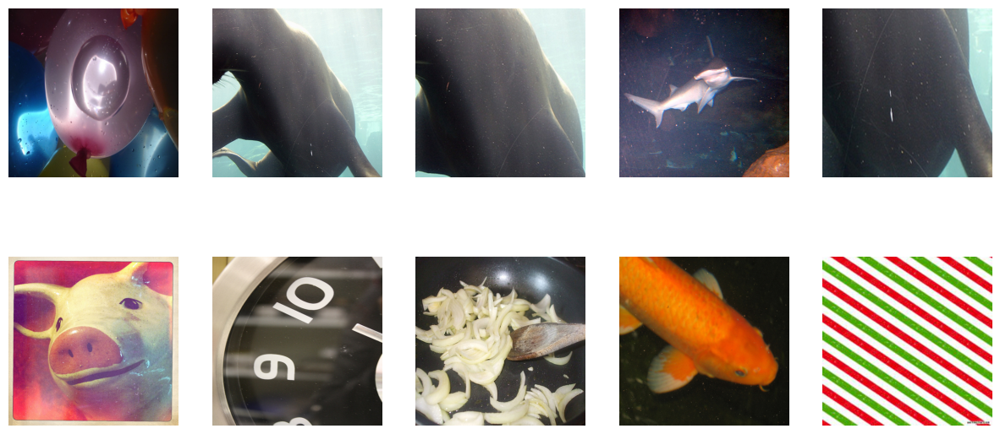

100%|██████████| 1/1 [00:00<00:00,  2.46it/s]


Image 1 caption: a bunch of balloons
Image 2 caption: a bear swimming in the water
Image 3 caption: a large black bear
Image 4 caption: a large fish swimming in a large tank
Image 5 caption: a man in a wet suit is swimming
Image 6 caption: a pig head on a piece of paper
Image 7 caption: a clock with the word stop written on it
Image 8 caption: onions are in a pan
Image 9 caption: a fish swimming in a pond
Image 10 caption: a red and green striped christmas background
Image 0 label: Animal and object imagery.
Image 1 label: Assorted visuals.
Image 2 label: Animal activities.
Image 3 label: Animal and time-related scenes.
Image 4 label: Assorted Animal and Activities Scenes.
Neuron: 473 (23/30)


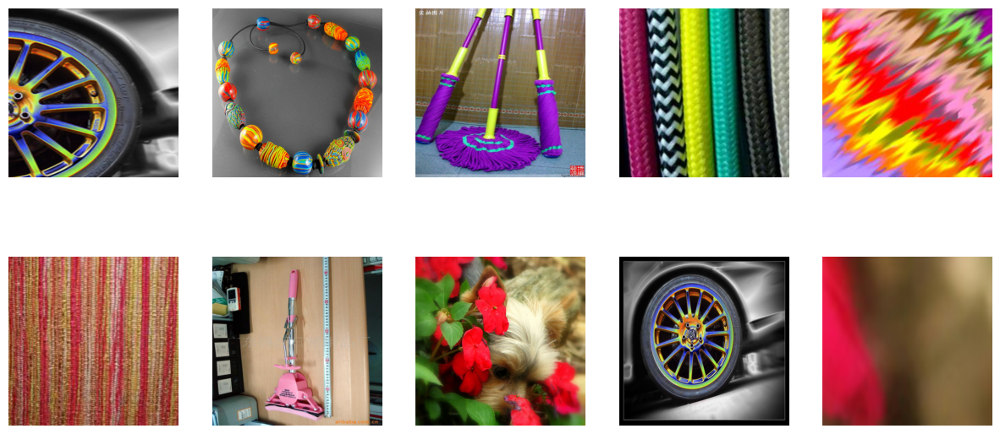

100%|██████████| 1/1 [00:00<00:00,  1.59it/s]


Image 1 caption: a car wheel with a yellow rim and blue spoke
Image 2 caption: a necklace with multi colored beads
Image 3 caption: a purple mop mop mop mop mop mop mop mop mop mo
Image 4 caption: a variety of braiding
Image 5 caption: a colorful abstract pattern with a rainbow colored background
Image 6 caption: a red and yellow striped pillow
Image 7 caption: a pink vacuum vacuum cleaner on a wooden table
Image 8 caption: a dog is laying in a flower bed
Image 9 caption: a car wheel with a rainbow painted wheel
Image 10 caption: a red flower with a blur effect
Image 0 label: Colorful objects.
Image 1 label: Colorful objects and patterns.
Image 2 label: Colorful objects and scenes.
Image 3 label: Colorful household items and accessories.
Image 4 label: Colorful household items and accessories.
Neuron: 488 (24/30)


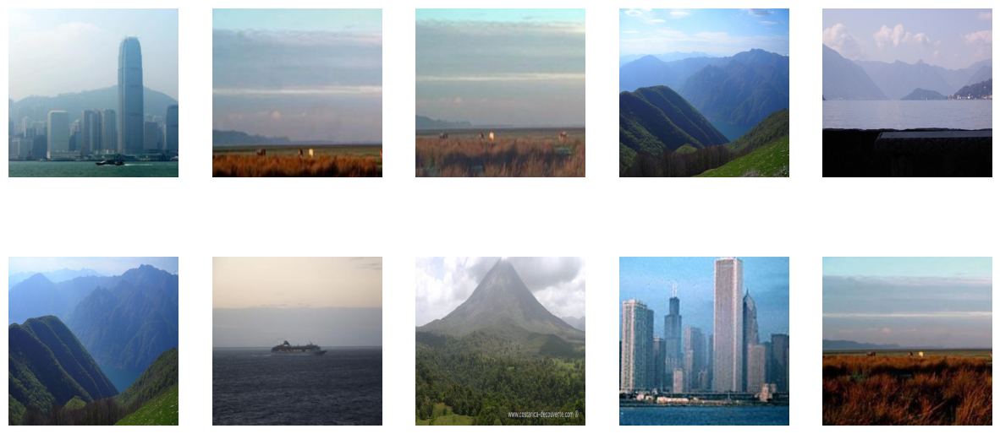

100%|██████████| 1/1 [00:00<00:00,  2.37it/s]


Image 1 caption: a body of water
Image 2 caption: a field of grass
Image 3 caption: a field of tall grass
Image 4 caption: the mountains are green
Image 5 caption: a view of a lake
Image 6 caption: the mountains are green
Image 7 caption: a large ship in the ocean
Image 8 caption: a mountain in the distance
Image 9 caption: the city skyline is shown in this photo
Image 10 caption: a field with a few cows grazing in the distance
Image 0 label: Nature scenes.
Image 1 label: Nature landscapes.
Image 2 label: Nature scenes.
Image 3 label: Nature scenes.
Image 4 label: Nature scenes.
Neuron: 504 (25/30)


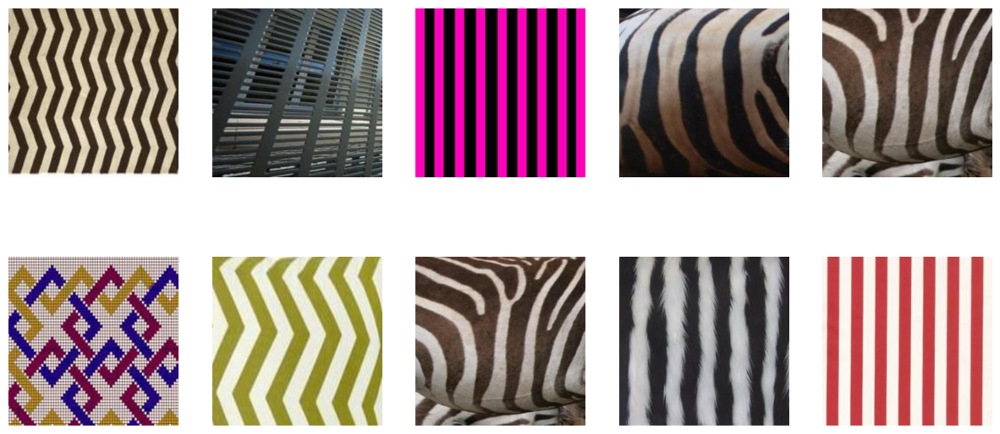

100%|██████████| 1/1 [00:00<00:00,  2.26it/s]


Image 1 caption: a rug with a che pattern on it
Image 2 caption: a large metal fence with a blue sky in the background
Image 3 caption: a pink and black striped pattern
Image 4 caption: a zebra laying on the ground
Image 5 caption: a zebra standing in a field of grass
Image 6 caption: a pattern of squares
Image 7 caption: a yellow and white pillow with a che pattern
Image 8 caption: a zebra standing in a field with other zebras
Image 9 caption: a black and white fur with white stripes
Image 10 caption: a red and white striped fabric
Image 0 label: Patterns and animals.
Image 1 label: Striped and patterned designs.
Image 2 label: Animal prints and patterns.
Image 3 label: Patterns and Textures.
Image 4 label: Black and white patterns.
Neuron: 526 (26/30)


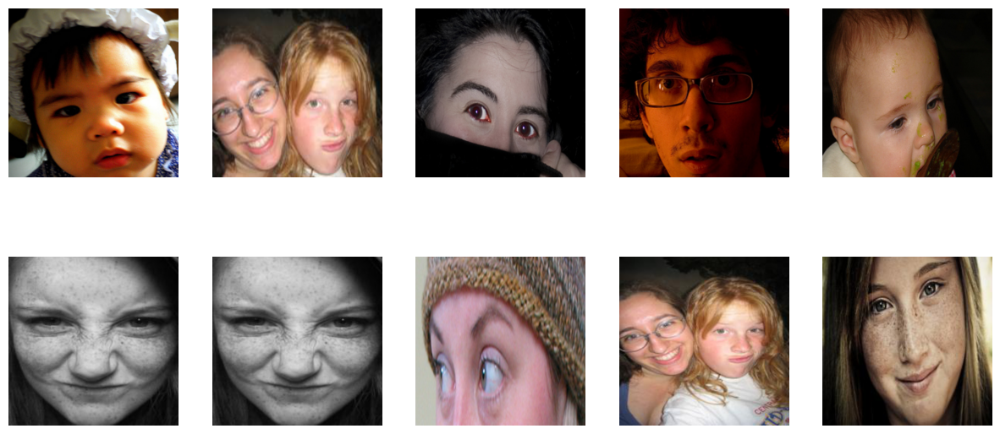

100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


Image 1 caption: a baby wearing a white hat
Image 2 caption: a woman and a girl are posing for a picture
Image 3 caption: a woman with dark hair
Image 4 caption: a man with glasses
Image 5 caption: a baby eating a chocolate covered dough
Image 6 caption: a woman with fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr
Image 7 caption: a woman with fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr
Image 8 caption: a woman with a hat on
Image 9 caption: a woman and a girl
Image 10 caption: a girl with fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr fr
Image 0 label: People with various features.
Image 1 label: People with hair and accessories.
Image 2 label: People with headwear or hairstyles.
Image 3 label: People with varied appearances.
Image 4 label: People with varied appearances.
Neuron: 574 (27/30)


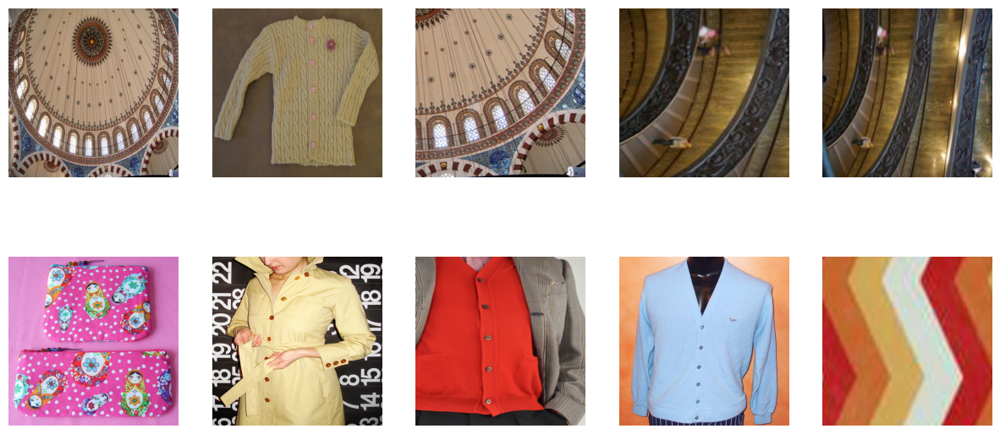

100%|██████████| 1/1 [00:00<00:00,  1.54it/s]


Image 1 caption: the ceiling is white
Image 2 caption: a sweater on the floor
Image 3 caption: a dome with a clock inside of a building
Image 4 caption: a group of people walking down a spiral staircase
Image 5 caption: a spiral staircase in a building
Image 6 caption: two small zipper bags with owls on them
Image 7 caption: a woman wearing a yellow coat
Image 8 caption: a man wearing a red vest and a gray vest
Image 9 caption: a blue cardigan sweater with a white stripe on the bottom
Image 10 caption: a red and yellow che che che che che che che che che che che che che che che che che
Image 0 label: Architectural and clothing elements.
Image 1 label: Clothing and Architecture
Image 2 label: Colorful clothing and architecture.
Image 3 label: Vertical structures and clothing.
Image 4 label: Colorful clothing and architecture.
Neuron: 582 (28/30)


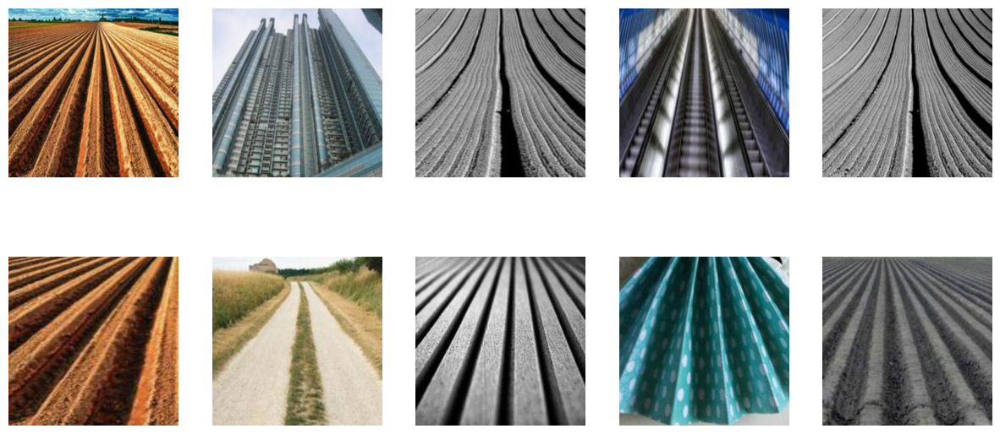

100%|██████████| 1/1 [00:00<00:00,  1.59it/s]


Image 1 caption: a field with a blue sky and clouds
Image 2 caption: a tall building with a lot of windows
Image 3 caption: a black and white photo of a large, curved, circular, rock formation
Image 4 caption: a subway train moving through a tunnel
Image 5 caption: a black and white photo of a large leaf
Image 6 caption: a row of rows of rows of rows of rows of rows of rows of rows of rows of rows of
Image 7 caption: a dirt road with a field of tall grass
Image 8 caption: a black and white photo of a wooden floor
Image 9 caption: a paper doll with a blue dress and polka dots
Image 10 caption: a field with rows of crops
Image 0 label: Various outdoor scenes.
Image 1 label: Monochromatic landscapes and objects.
Image 2 label: Monochrome urban and rural scenes
Image 3 label: Nature and man-made structures.
Image 4 label: Monochrome urban and nature scenes.
Neuron: 607 (29/30)


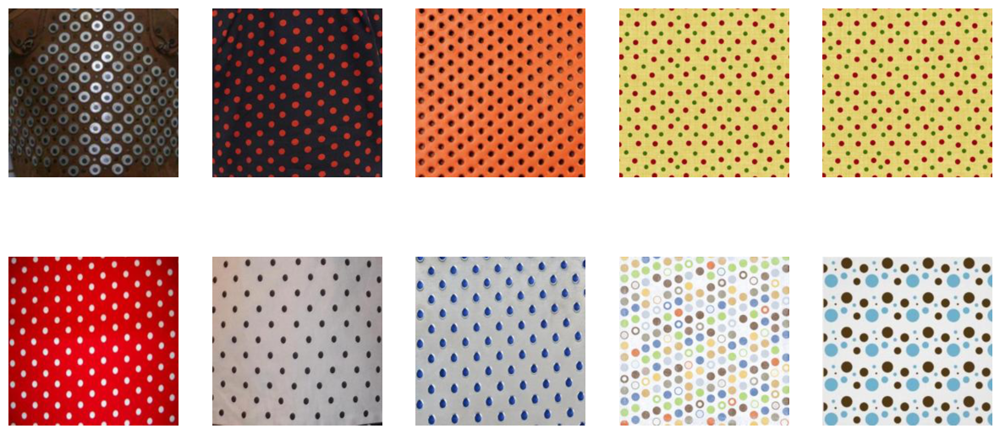

100%|██████████| 1/1 [00:00<00:00,  2.36it/s]


Image 1 caption: a brown and white hat with a large eyeball
Image 2 caption: a black and red polka dot print dress
Image 3 caption: a close up of a red leather texture
Image 4 caption: a yellow background with red and green polka dots
Image 5 caption: a yellow background with red and green polka dots
Image 6 caption: a red polka dot fabric with white polka dots
Image 7 caption: a black and white polka dot pillow
Image 8 caption: a metal sheet with blue dots
Image 9 caption: a white background with colorful circles and dots
Image 10 caption: a blue and brown polka dot pattern wrapping paper
Image 0 label: Polka dot fashion.
Image 1 label: Polka dot patterns.
Image 2 label: Polka dot patterns.
Image 3 label: Polka dot patterns.
Image 4 label: Polka dot patterns.
Neuron: 624 (30/30)


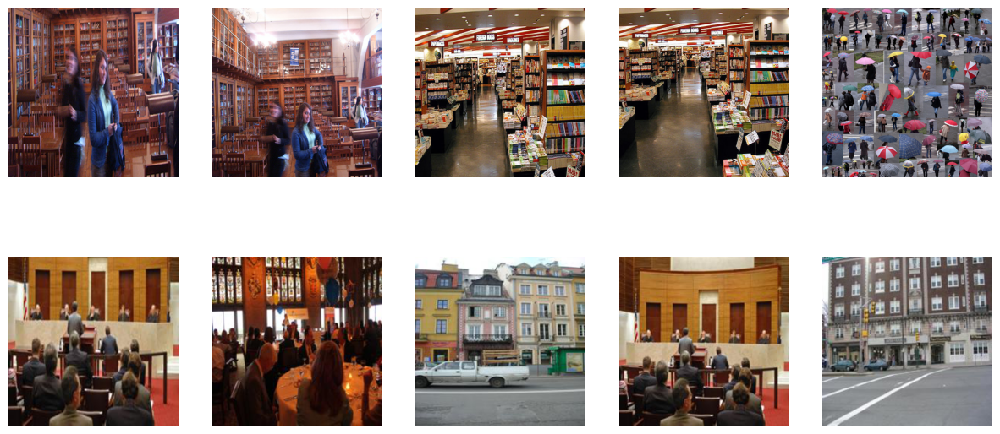

100%|██████████| 1/1 [00:00<00:00,  2.08it/s]


Image 1 caption: a group of people standing in a library
Image 2 caption: a group of people walking through a library
Image 3 caption: a large book store with a lot of books
Image 4 caption: a large book store with a long row of books
Image 5 caption: a col of people walking in the rain
Image 6 caption: a large room with a red carpet
Image 7 caption: a large room with a long table
Image 8 caption: a white truck driving down a street next to a row of buildings
Image 9 caption: a large room with a red carpet
Image 10 caption: a street sign on a pole
Image 0 label: Indoor and outdoor scenes.
Image 1 label: Indoor spaces for reading.
Image 2 label: Indoor and outdoor spaces.
Image 3 label: Indoor and outdoor scenes.
Image 4 label: Indoor Spaces and Places.


In [17]:
# Get candidate concepts, generate BLIP captions and combine with GPT

target_feats = utils.get_target_activations(target_name, all_imgs, [target_layer])

top_vals, top_ids = torch.sort(target_feats, dim=0, descending = True)
comp_words = {}
top_images = {orig_id:[] for orig_id in ids_to_check}

create_layer_folder(target_layer, tag)

for neuron_num, orig_id in enumerate(ids_to_check):
    print("Neuron: {} ({}/{})".format(orig_id, neuron_num+1, len(ids_to_check)))
    descriptions = []
    images = []
    
    fig = plt.figure(figsize=(15, 7))
    i = 0
    for top_id in top_ids[:, orig_id]:
        if len(images) == min(blip_batch_size, num_images_to_check):
            break
        im = all_imgs[top_id]
        im = im.resize([375,375])
        images.append(im)
        top_images[orig_id].append(im)
        fig.add_subplot(2, 5, i+1)
        i+=1
        plt.imshow(im)
        plt.axis('off')
    save_activating_fig(fig, target_layer, orig_id)
    plt.show()
    plt.close()
    
    gen_kwargs = {"max_length": 32, "min_length": 5}
    custom_dataset = CustomDataset(images)
    dataloader = DataLoader(custom_dataset, batch_size=blip_batch_size, shuffle=True)
        
    for batch in tqdm(dataloader):
        pixel_values = processor(images=images, return_tensors="pt").pixel_values.to(device)
        out = model.generate(pixel_values=pixel_values, **gen_kwargs)
        captions = processor.batch_decode(out, skip_special_tokens=True)
        descriptions.extend(captions)
    cap_count = 1
    for cap in descriptions:
        cap = cap.replace("output : ", "")
        cap = cap.replace("< | eos | >", "")
        cap = cap.replace("<", "")
        cap = cap.replace("|", "")
        cap = cap.replace("eos", "")
        cap = cap.replace(">", "")
        cap = cap.replace("'", "")
        cap = cap.replace('"', '')
        print("Image {} caption: {}".format(cap_count, cap))
        cap_count += 1
        
    for i, description in enumerate(descriptions):
        descriptions[i] = GPT_simplify(description)
    # Combining BLIP descrptions into one description
    all_blip_preds = []
    for _ in range(5):
        blip_preds = GPT_model_single(descriptions)
        all_blip_preds.append(blip_preds)
        random.shuffle(descriptions)
    
    for i, label in enumerate(all_blip_preds):
        print("Image {} label: {}".format(i, label))
        
    comp_words[orig_id] = all_blip_preds
    save_potential_concepts(comp_words[orig_id], orig_id)

os.chdir(save_potential_concept_path(target_layer, tag))
all_concepts.to_csv('all_potential_concepts.csv', index=False)
os.chdir(home_dir + '/Generative-Dissection')
del all_concepts

In [18]:
os.chdir(home_dir)
os.chdir('Generative-Dissection')

with open(concept_set, 'r') as f:
        words = f.read().split('\n')

# Find index of word in concept set
def get_id_for_word(word):
    with open(concept_set, 'r') as f:
        words = f.read().split('\n')
    try:
        return words.index(word)
    except:
        print("Error: Word is not in concept set, {} found expected {}".format(type(word), type('str')))

# Get pre-generated images
def get_images(word, images_to_pull, old_path, new_path, home_dir):

    concept_id = get_id_for_word(word)
    
    os.chdir(home_dir)
    os.chdir(new_path)
    
    random_ids = []

    # Pull random images from image set
    while len(random_ids) < images_to_pull:
        rnd_id = random.randint(0,20)
        if rnd_id not in random_ids: 
            random_ids.append(rnd_id)
    
    image_set = []
    for img_id in random_ids:
        img = Image.open(r'imagenet_labels_concept_{}_image_{}.png'.format(concept_id, img_id))
        image_set.append(img)
    
    os.chdir(old_path)
    
    return image_set

def detect_vague(target_images, check_im_num = 5):
    
    clip_model, clip_preprocess = clip.load(clip_name, device=device)

    all_features = utils.get_clip_image_features(clip_model, clip_preprocess, target_images).float()
    all_features /= all_features.norm(dim=-1, keepdim=True)

    inner = (all_features @ all_features.T)
    sim_idx = torch.mean(inner)
    
    return sim_idx

def norm_vals(top_avg2):
    top_avg2 = [(float((top_avg2[i][0] - 0.7)/0.27), top_avg2[i][1]) for i in range(len(top_avg2))]
    return top_avg2
    
def find_by_last(top_avg, comp_key):
    for i, pair in enumerate(top_avg):
        if pair[1] == comp_key:
            return i
    raise Exception("Invalid label id")

In [19]:
# Scoring Methods

mode_list = ['topk-sq-mean', 'reg', 'mean', 'median', 'sq-mean', 'compare_images+topk_sq_mean', 'compare_images+mean']

# remove outliers from image rankings
def rm_outliers(ranks, rm_low_outliers, rm_high_outliers):
    for label_id in ranks:
        rank_arr = np.array(ranks[label_id])
        q1 = np.quantile(rank_arr, 0.25)
        q3 = np.quantile(rank_arr, 0.75)
        iqr = q3-q1
        
        new_ranks = []
        for pos in rank_arr:
            if rm_low_outliers == True and pos < q1 - (iqr * 1.5):
                continue
            if rm_high_outliers == True and pos > q3 + (iqr * 1.5):
                continue
            else:
                new_ranks.append(pos)
        ranks[label_id] = new_ranks
    return ranks

# mean of top-k values squared
def topk_sq_mean(ranks, k = 5):
    top_vals = []
    for label_id in ranks:
        sq_sum = 0
        for i in range(min(k, len(ranks[label_id]))):
            sq_sum += (ranks[label_id][i] ** 2)
        if len(ranks[label_id]) == 0:
            top_vals.append((len(ranks) + 1, label_id))
        else: 
            top_vals.append((sq_sum / min(k, len(ranks[label_id])), label_id))
    top_vals.sort()
    return top_vals

# regression + prediction
def reg(ranks, quartile = 0.25):
    top_vals = []
    X_vals = [i for i in range(len(ranks[0]))]
    p = quartile * float(len(ranks[0]))
    
    for label_id in ranks:
        regr = LinearRegression()
        regr.fit([X_vals], [ranks[label_id]])
        pred = regr.predict(np.array([p for _ in range(len(ranks[0]))]).reshape((-1,len(ranks[0]))))[0][0]
        top_vals.append((pred**3,label_id))
    top_vals.sort()
    return top_vals

def mean(ranks):
    top_vals = []
    for label_id in ranks:
        if len(ranks[label_id]) == 0:
            top_vals.append((len(ranks) + 1, label_id))
        else: 
            top_vals.append((sum(ranks[label_id])/len(ranks[label_id]), label_id))
    top_vals.sort()
    return top_vals

def median(ranks):
    top_vals = []
    for label_id in ranks:
        top_vals.append((stats.median(ranks[label_id]), label_id))
    top_vals.sort()
    return top_vals

# mean of squared values
def sq_mean(ranks):
    top_vals = []
    for label_id in ranks:
        top_vals.append((sum([val**2 for val in ranks[label_id]])/len(ranks[label_id]), label_id))
    top_vals.sort()
    return top_vals

def compare_images(target_images, all_generated_images, num_images = 5):
    top_vals = []
    
    clip_model, clip_preprocess = clip.load(clip_name, device=device)
    target_model, target_preprocess = data_utils.get_target_model(target_name, device)
        
    target_features = utils.get_clip_image_features(clip_model, clip_preprocess, target_images, device = device).float()
    target_features /= target_features.norm(dim=-1, keepdim=True)
    
    for label_id in all_generated_images:
        
        generated_images = all_generated_images[label_id]

        if len(generated_images) == 0:
            top_vals.append((-1, label_id))
            continue
            
        generated_features = utils.get_clip_image_features(clip_model, clip_preprocess, generated_images, device = device).float()
        generated_features /= generated_features.norm(dim=-1, keepdim=True)

        inner = (target_features @ generated_features.T)

        sim_idx = torch.mean(inner)
        
        top_vals.append((sim_idx, label_id))
    
    top_vals.sort(reverse=True)
    return top_vals
    
# get score of label
def get_score(ranks, mode = 'topk-sq-mean', hyp_param = None, rm_low_outliers = False, rm_high_outliers = False):
    if mode not in mode_list:
        raise Exception("Invalid score mode '{}'".format(mode))
    
    if rm_low_outliers == True or rm_high_outliers == True:
        ranks = rm_outliers(ranks, rm_low_outliers, rm_high_outliers)
    
    if mode == 'topk-sq-mean' or mode == 'compare_images+topk_sq_mean':
        return topk_sq_mean(ranks, hyp_param)
    if mode == 'reg':
        return reg(ranks, hyp_param)
    if mode == 'mean' or mode == 'compare_images+mean':
        return mean(ranks)
    if mode == 'median':
        return median(ranks)
    if mode == 'sq-mean':
        return sq_mean(ranks)

In [20]:
# Modify candid

replace_set = ['design','designs','graphic','graphics']
for orig_id in comp_words:
    comp_words[orig_id] = [concept.lower() for concept in comp_words[orig_id]]
    for i, word in enumerate(comp_words[orig_id]):
        if word[-1] == '.':
            comp_words[orig_id][i] = word[:-1]
        if word.split()[-1] in replace_set:
            new_concept = word + ' background'
            comp_words[orig_id].append(new_concept)
    comp_words[orig_id] = list(set(comp_words[orig_id]))

In [21]:
os.chdir(home_dir)
os.chdir('Generative-Dissection')

# del image_set
torch.cuda.empty_cache()
            
pil_data = data_utils.get_data(d_probe)
d_probe_len = len(pil_data)
neurons_to_check = [i for i in comp_words]
all_final_results = {neuron_id : [] for neuron_id in neurons_to_check}

# Block configuration = (# labels to collect, #image per label, (#scoring model, hyperparameter if required))
it_settings = (10, 10, 5)

# Main code
for list_id, orig_id in enumerate(neurons_to_check):

    # Initialize starting concepts
    word_list = comp_words[orig_id]
    best_label = word_list[0]
    
    print("Neuron {}".format(orig_id))

    # Get block settings
    num_images_per_prompt, hyp_param1, hyp_param2 = it_settings

    # Account for added generative label (if necessary)
    labels_to_check = len(word_list)

    print("# Labels Checked: {}".format(labels_to_check), "   # Images per Concept: {}".format(num_images_per_prompt))

    add_im = {}
    add_im_id = {}
    all_imgs = []

    print('Gathering images...')

    # Generate images for each label
    bad_count = 0

    for label_id in range(labels_to_check):

        pred_label = 'One realistic image of {}'.format(word_list[label_id])

        add_im_id[label_id] = [] # initialize image list

        # Generate images
        print("Label {}/{}: {}".format(label_id + 1, labels_to_check, word_list[label_id]))
        image_set = pipe(pred_label, generator = generator, num_images_per_prompt = num_images_per_prompt, num_inference_steps=15)


        # Use this if using pre-generated images
        # image_set = get_images(pred_label, num_images_per_prompt, old_path = os.getcwd(), home_dir = home_dir, new_path = '/expanse/lustre/scratch/riyer/temp_project/generated_images')

        for i in range(num_images_per_prompt):
            # Use this if using pre-generated images
            #image = image_set[i]

            # Rescale image
            image = image_set.images[i]
            image = image.resize([32,32])

            all_imgs.append(image)
            new_idx = len(add_im)
            add_im[new_idx] = image # Add image to list
            add_im_id[label_id].append(new_idx) # map new image indices to corresponding label_id
    print('Done')
    del image_set
    torch.cuda.empty_cache()

    if bad_count == labels_to_check:
        break

    target_feats = utils.get_target_activations(target_name, all_imgs, [target_layer])

    # Sort images based on activation
    top_vals, top_ids = torch.sort(target_feats, dim=0, descending = True)
    top_image_id = top_ids[:,orig_id]

    # Ranks: label_id -> (indicies of corresponding images in sorted target_feats)
    ranks = {label_id:[] for label_id in range(labels_to_check)}
    highest_activating = {label_id:[] for label_id in range(labels_to_check)}

    # Insert indices of image activations into ranks
    for label_id in range(labels_to_check):
        for i, img_id in enumerate(top_image_id):
            if img_id.item() in add_im_id[label_id]:
                ranks[label_id].append(i)
                if i < hyp_param1:
                    highest_activating[label_id].append(add_im[img_id.item()])
        ranks[label_id].sort()

    # Compare all Scoring Methods

    # Compare images
    
    top_avg1 = compare_images(top_images[orig_id], highest_activating, hyp_param1)

    # Topk-sq-mean
    top_avg_topk = get_score(ranks, 'topk-sq-mean', hyp_param2)
    top_avg2 = top_avg_topk

    # Combined

    top_avg_comb = [(float((len(top_avg2) - find_by_last(top_avg2, top_avg1[i][1])) * (top_avg1[i][0])),top_avg1[i][1]) for i in range(len(top_avg1))]
    top_avg_comb.sort(reverse = True)
    
    for label_num in range(3):
        if(label_num < len(top_avg_comb)):
            all_final_results[orig_id] += [word_list[top_avg_comb[label_num][1]]]
        else:
            all_final_results[orig_id] += [' ']
    
    print('------------------------------\n')
    print('Neuron {}:'.format(orig_id))
    for k, word in enumerate(all_final_results[orig_id]):
        if(word != " "):
            print("Label {}: {}".format(k + 1, word))
        else:
            break
    print('\n------------------------------')
    
    save_final_results(all_final_results[orig_id], orig_id)
    
os.chdir(save_result_concepts_path(target_layer, tag))
final_concepts.to_csv('final_results.csv', index=False)
os.chdir(home_dir + '/Generative-Dissection')
del final_concepts

Neuron 44
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: animals on furniture


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: animal-related objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: white animals in various settings


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: animal-related scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 44:
Label 1: white animals in various settings
Label 2: animal-related scenes
Label 3: animals on furniture

------------------------------
Neuron 94
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: colors and objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: various objects in colors


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: colorful objects and food


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: colorful objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: food and nature items


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 94:
Label 1: colorful objects and food
Label 2: colorful objects
Label 3: various objects in colors

------------------------------
Neuron 170
# Labels Checked: 2    # Images per Concept: 10
Gathering images...
Label 1/2: patterns and textures in nature and design


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/2: patterns and textures


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 170:
Label 1: patterns and textures
Label 2: patterns and textures in nature and design

------------------------------
Neuron 188
# Labels Checked: 3    # Images per Concept: 10
Gathering images...
Label 1/3: spider webs with droplets and red background


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/3: spider webs and leaves


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/3: spider webs and nature


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 188:
Label 1: spider webs and leaves
Label 2: spider webs with droplets and red background
Label 3: spider webs and nature

------------------------------
Neuron 192
# Labels Checked: 3    # Images per Concept: 10
Gathering images...
Label 1/3: everyday objects and scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/3: colorful objects and scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/3: everyday objects and scenery


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 192:
Label 1: everyday objects and scenes
Label 2: colorful objects and scenes
Label 3: everyday objects and scenery

------------------------------
Neuron 201
# Labels Checked: 3    # Images per Concept: 10
Gathering images...
Label 1/3: patterns and birds


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/3: birds and patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/3: bird and pattern motifs


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 201:
Label 1: bird and pattern motifs
Label 2: patterns and birds
Label 3: birds and patterns

------------------------------
Neuron 236
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: objects with different textures and colors


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: objects with distinct textures


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: objects made of wood and plastic


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: objects on white background


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: photography and writing tools


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 236:
Label 1: objects made of wood and plastic
Label 2: objects with different textures and colors
Label 3: photography and writing tools

------------------------------
Neuron 244
# Labels Checked: 3    # Images per Concept: 10
Gathering images...
Label 1/3: checkered items


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/3: checkered and woven items


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/3: checkered items and backgrounds


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 244:
Label 1: checkered items and backgrounds
Label 2: checkered items
Label 3: checkered and woven items

------------------------------
Neuron 245
# Labels Checked: 3    # Images per Concept: 10
Gathering images...
Label 1/3: animal-related objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/3: animals and objects in surroundings


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/3: animal-related items


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 245:
Label 1: animal-related objects
Label 2: animal-related items
Label 3: animals and objects in surroundings

------------------------------
Neuron 284
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: body parts and clothing


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: color and texture


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: body and nature


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: body parts and textures


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: visual elements


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 284:
Label 1: body and nature
Label 2: body parts and textures
Label 3: body parts and clothing

------------------------------
Neuron 299
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: fashion and architecture


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: dark and metallic items


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: patterns and structures


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: metallic and textured objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: metal and fabric items


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 299:
Label 1: fashion and architecture
Label 2: dark and metallic items
Label 3: patterns and structures

------------------------------
Neuron 311
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: patterns and accessories


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: clothing and accessories with animal motifs


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: assorted accessories


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: animal-inspired accessories and armor


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: assorted patterns and textures


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 311:
Label 1: clothing and accessories with animal motifs
Label 2: animal-inspired accessories and armor
Label 3: assorted accessories

------------------------------
Neuron 316
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: pets and patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: black and white accessories and animals


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: black and white motifs


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: black and white pets and accessories


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 316:
Label 1: black and white pets and accessories
Label 2: pets and patterns
Label 3: black and white accessories and animals

------------------------------
Neuron 326
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: colorful geometric patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: geometric patterned decor


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: zigzag and chevron patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: chevron and zigzag patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: chevron pattern decor


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 326:
Label 1: chevron pattern decor
Label 2: colorful geometric patterns
Label 3: chevron and zigzag patterns

------------------------------
Neuron 327
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: group activities


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: outdoor activities and objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: patterns and people


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: male activities and objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: people in various activities


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 327:
Label 1: male activities and objects
Label 2: group activities
Label 3: people in various activities

------------------------------
Neuron 348
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: abstract objects and scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: colorful objects and scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: various visual objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: colorful objects/scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 348:
Label 1: colorful objects/scenes
Label 2: colorful objects and scenes
Label 3: various visual objects

------------------------------
Neuron 386
# Labels Checked: 3    # Images per Concept: 10
Gathering images...
Label 1/3: chevron-themed decor


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/3: geometric decor


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/3: geometric home decor


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 386:
Label 1: chevron-themed decor
Label 2: geometric decor
Label 3: geometric home decor

------------------------------
Neuron 396
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: assorted scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: white and nature scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: various scenes with white elements


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: various scenes and objects


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 396:
Label 1: white and nature scenes
Label 2: assorted scenes
Label 3: various scenes and objects

------------------------------
Neuron 397
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: monochrome patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: geometric patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: monochrome and seating arrangements


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: geometric patterns and people


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: geometric patterns and colors


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 397:
Label 1: geometric patterns and colors
Label 2: monochrome patterns
Label 3: monochrome and seating arrangements

------------------------------
Neuron 416
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: portraits of people


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: portraits of people's hair


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: black and white portraits of women


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: portrait photography


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: various hairstyles


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 416:
Label 1: various hairstyles
Label 2: black and white portraits of women
Label 3: portraits of people

------------------------------
Neuron 417
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: white and black objects in a room


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: table and stage setup


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: interior design elements


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: tabletop displays


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: white and black furnishings and objects


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 417:
Label 1: tabletop displays
Label 2: interior design elements
Label 3: table and stage setup

------------------------------
Neuron 449
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: assorted animal and activities scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: animal activities


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: assorted visuals


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: animal and time-related scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: animal and object imagery


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 449:
Label 1: assorted visuals
Label 2: animal activities
Label 3: animal and time-related scenes

------------------------------
Neuron 473
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: colorful objects and scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: colorful household items and accessories


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: colorful objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: colorful objects and patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 473:
Label 1: colorful household items and accessories
Label 2: colorful objects
Label 3: colorful objects and scenes

------------------------------
Neuron 488
# Labels Checked: 2    # Images per Concept: 10
Gathering images...
Label 1/2: nature landscapes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/2: nature scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 488:
Label 1: nature landscapes
Label 2: nature scenes

------------------------------
Neuron 504
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: striped and patterned designs


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: animal prints and patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: patterns and textures


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: black and white patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: patterns and animals


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 504:
Label 1: striped and patterned designs
Label 2: animal prints and patterns
Label 3: patterns and animals

------------------------------
Neuron 526
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: people with hair and accessories


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: people with varied appearances


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: people with various features


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: people with headwear or hairstyles


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 526:
Label 1: people with various features
Label 2: people with headwear or hairstyles
Label 3: people with hair and accessories

------------------------------
Neuron 574
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: colorful clothing and architecture


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: clothing and architecture


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: architectural and clothing elements


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: vertical structures and clothing


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 574:
Label 1: architectural and clothing elements
Label 2: colorful clothing and architecture
Label 3: clothing and architecture

------------------------------
Neuron 582
# Labels Checked: 5    # Images per Concept: 10
Gathering images...
Label 1/5: nature and man-made structures


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/5: monochrome urban and rural scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/5: monochromatic landscapes and objects


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/5: monochrome urban and nature scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 5/5: various outdoor scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 582:
Label 1: monochrome urban and nature scenes
Label 2: nature and man-made structures
Label 3: monochrome urban and rural scenes

------------------------------
Neuron 607
# Labels Checked: 2    # Images per Concept: 10
Gathering images...
Label 1/2: polka dot patterns


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/2: polka dot fashion


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 607:
Label 1: polka dot patterns
Label 2: polka dot fashion

------------------------------
Neuron 624
# Labels Checked: 4    # Images per Concept: 10
Gathering images...
Label 1/4: indoor and outdoor scenes


  0%|          | 0/15 [00:00<?, ?it/s]

Label 2/4: indoor spaces and places


  0%|          | 0/15 [00:00<?, ?it/s]

Label 3/4: indoor and outdoor spaces


  0%|          | 0/15 [00:00<?, ?it/s]

Label 4/4: indoor spaces for reading


  0%|          | 0/15 [00:00<?, ?it/s]

Done
------------------------------

Neuron 624:
Label 1: indoor spaces for reading
Label 2: indoor spaces and places
Label 3: indoor and outdoor scenes

------------------------------


In [22]:
def image_embedding_mean(img_set):
    clip_model, clip_preprocess = clip.load(clip_name, device=device)
    
    image_features = utils.get_clip_image_features(clip_model, clip_preprocess, img_set, device = device)
    image_features /= image_features.norm(dim=-1, keepdim=True)
    embedding_matrix = image_features @ image_features.T
    
    return torch.mean(embedding_matrix)

def text_embedding_mean(labels):
    clip_model, clip_preprocess = clip.load(clip_name, device=device)
    
    text_features = []
    labels = clip.tokenize(["{}".format(word) for word in labels]).to(device)
    with torch.no_grad():
        for i in range(math.ceil(len(labels)/batch_size)):
            text_features.append(clip_model.encode_text(labels[batch_size*i:batch_size*(i+1)]))
    text_features = torch.cat(text_features, dim=0)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    embedding_matrix = text_features @ text_features.T
    
    return torch.mean(embedding_matrix)

for i, orig_id in enumerate(ids_to_check):
    print('Saving Neuron {} ({}/{})'.format(orig_id, i+1, len(ids_to_check)))
    data = all_final_results[orig_id] + [image_embedding_mean(top_images[orig_id]).tolist()] + [text_embedding_mean(comp_words[orig_id]).tolist()]
    save_threshold_results(orig_id, data)
    
os.chdir(save_threshold_path(target_layer, tag))
threshold_results.to_csv('threshold_results.csv', index=False)
os.chdir(home_dir + '/Generative-Dissection')

Saving Neuron 44 (1/30)
Saving Neuron 94 (2/30)
Saving Neuron 170 (3/30)
Saving Neuron 188 (4/30)
Saving Neuron 192 (5/30)
Saving Neuron 201 (6/30)
Saving Neuron 236 (7/30)
Saving Neuron 244 (8/30)
Saving Neuron 245 (9/30)
Saving Neuron 284 (10/30)
Saving Neuron 299 (11/30)
Saving Neuron 311 (12/30)
Saving Neuron 316 (13/30)
Saving Neuron 326 (14/30)
Saving Neuron 327 (15/30)
Saving Neuron 348 (16/30)
Saving Neuron 386 (17/30)
Saving Neuron 396 (18/30)
Saving Neuron 397 (19/30)
Saving Neuron 416 (20/30)
Saving Neuron 417 (21/30)
Saving Neuron 449 (22/30)
Saving Neuron 473 (23/30)
Saving Neuron 488 (24/30)
Saving Neuron 504 (25/30)
Saving Neuron 526 (26/30)
Saving Neuron 574 (27/30)
Saving Neuron 582 (28/30)
Saving Neuron 607 (29/30)
Saving Neuron 624 (30/30)
